<a href="https://colab.research.google.com/github/EsdFatima/textile-defect-detection-using-object-detection-algorithms/blob/main/Copy_of_Datacollectedfasterrcnn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!nvidia-smi

Tue May 30 17:01:31 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 14.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44090 sha256=13355c7f61c1291ef5839e1f78f51328bbc7318843f590f8f9848b19ece64a93
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
flax 0.6.9 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatibl

In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

2.0.1+cu118 True


In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
%cd /content/drive/MyDrive/data-pfe/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT

/content/drive/MyDrive/outpt


In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("exr", {}, "/content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/train/_annotations.coco.json", "/content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/train")


In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("x", {}, "/content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/test/_annotations.coco.json", "/content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/test")


In [ ]:
sample_metadata=MetadataCatalog.get("exr")
dataset_dicts=DatasetCatalog.get("exr")
microcontroller_metadata = MetadataCatalog.get("exr")

WARNING [05/30 18:49:33 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 18:49:33 d2.data.datasets.coco]: Loaded 336 images in COCO format from /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/train/_annotations.coco.json


In [ ]:
sample_metadata=MetadataCatalog.get("x")
dataset_dict=DatasetCatalog.get("x")
microcontroller_metadata = MetadataCatalog.get("x")

WARNING [05/30 18:49:48 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 18:49:48 d2.data.datasets.coco]: Loaded 17 images in COCO format from /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/test/_annotations.coco.json


In [ ]:
import random
for d in random.sample(dataset_dicts, 4):
    img= cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :,::-1], metadata=sample_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :,::-1])

In [ ]:

!git clone https://github.com/facebookresearch/detectron2 detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 15057, done.
remote: Counting objects: 100% (82/82), done.
remote: Compressing objects: 100% (45/45), done.
remote: Total 15057 (delta 38), reused 69 (delta 37), pack-reused 14975
Receiving objects: 100% (15057/15057), 6.12 MiB | 5.76 MiB/s, done.
Resolving deltas: 100% (10903/10903), done.


# **R101-C4**

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_C4_3x.yaml"))
cfg.DATASETS.TRAIN = ("exr",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_C4_3x.yaml")# initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.005
cfg.SOLVER.MAX_ITER = 400   # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  # 3 classes (Person, Helmet, Car)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/30 18:51:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_298dad.pkl: 212MB [00:01, 203MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/30 18:51:05 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/30 18:51:32 d2.utils.events]:  eta: 0:05:37  iter: 19  total_loss: 1.661  loss_cls: 1.13  loss_box_reg: 0.3405  loss_rpn_cls: 0.2373  loss_rpn_loc: 0.03576    time: 0.8734  last_time: 0.9653  data_time: 0.3151  last_data_time: 0.3430   lr: 0.00024226  max_mem: 2682M
[05/30 18:51:55 d2.utils.events]:  eta: 0:05:19  iter: 39  total_loss: 0.7624  loss_cls: 0.289  loss_box_reg: 0.4473  loss_rpn_cls: 0.04345  loss_rpn_loc: 0.006014    time: 0.9184  last_time: 0.8846  data_time: 0.2411  last_data_time: 0.2683   lr: 0.00049201  max_mem: 2682M
[05/30 18:52:12 d2.utils.events]:  eta: 0:05:00  iter: 59  total_loss: 0.6971  loss_cls: 0.2024  loss_box_reg: 0.4242  loss_rpn_cls: 0.03582  loss_rpn_loc: 0.02033    time: 0.9050  last_time: 0.8413  data_time: 0.2883  last_data_time: 0.2400   lr: 0.00074176  max_mem: 2682M
[05/30 18:52:31 d2.utils.events]:  eta: 0:04:44  iter: 79  total_loss: 0.6603  loss_cls: 0.1086  loss_box_reg: 0.4727  loss_rpn_cls: 0.01505  loss_rpn_loc: 0.01889    time: 0.9081

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("exr", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "exr", mapper=None)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/30 19:04:03 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/30 19:04:03 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/30 19:04:03 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 19:04:03 d2.data.datasets.coco]: Loaded 336 images in COCO format from /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/train/_annotations.coco.json
[05/30 19:04:03 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/30 19:04:03 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/30 19:04:03 d2.data.common]: Serializing 336 elements to byte tensors and concatenating them all ...
[

OrderedDict([('bbox',
              {'AP': 28.846174988802304,
               'AP50': 48.27019349792168,
               'AP75': 32.14967049231006,
               'APs': 5.70552025820229,
               'APm': 12.623762376237622,
               'APl': 52.15907950407102,
               'AP-knot-broken-smallhole-bighole-': nan,
               'AP-big hole': 69.64936877215068,
               'AP-broken': 34.65169245764091,
               'AP-knot': 11.083638725417618,
               'AP-small hole': 0.0})])

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("x",)
predictor = DefaultPredictor(cfg)

[05/30 19:08:00 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


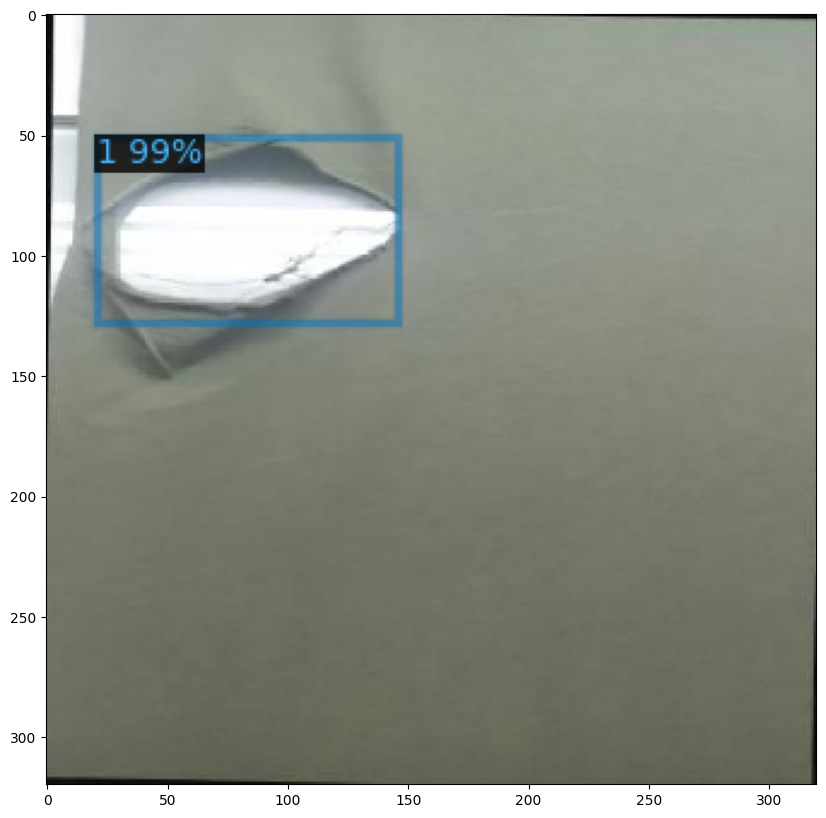

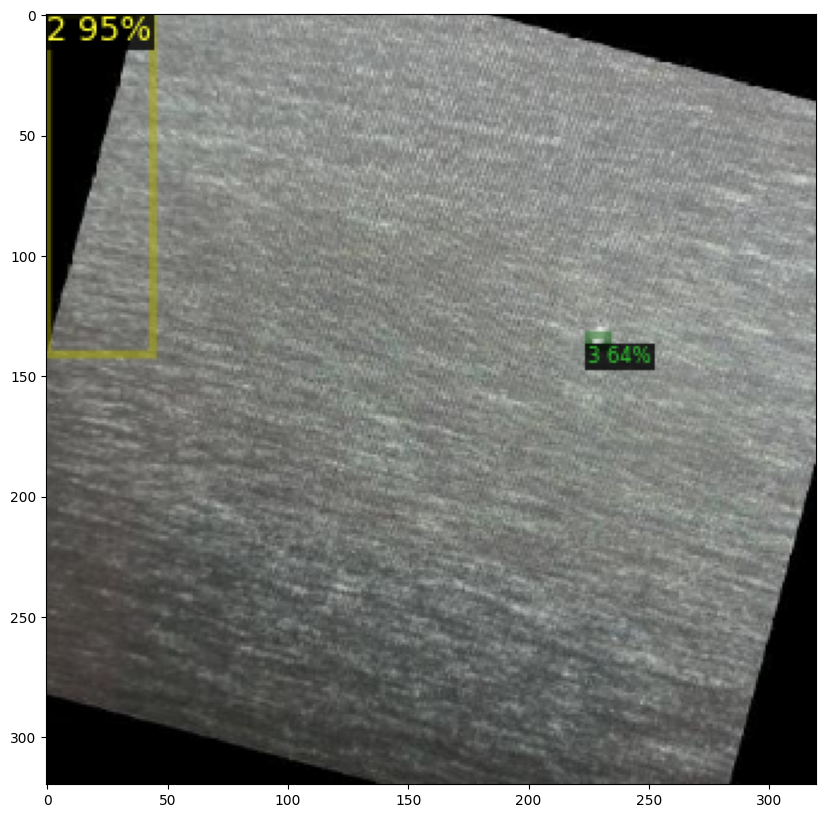

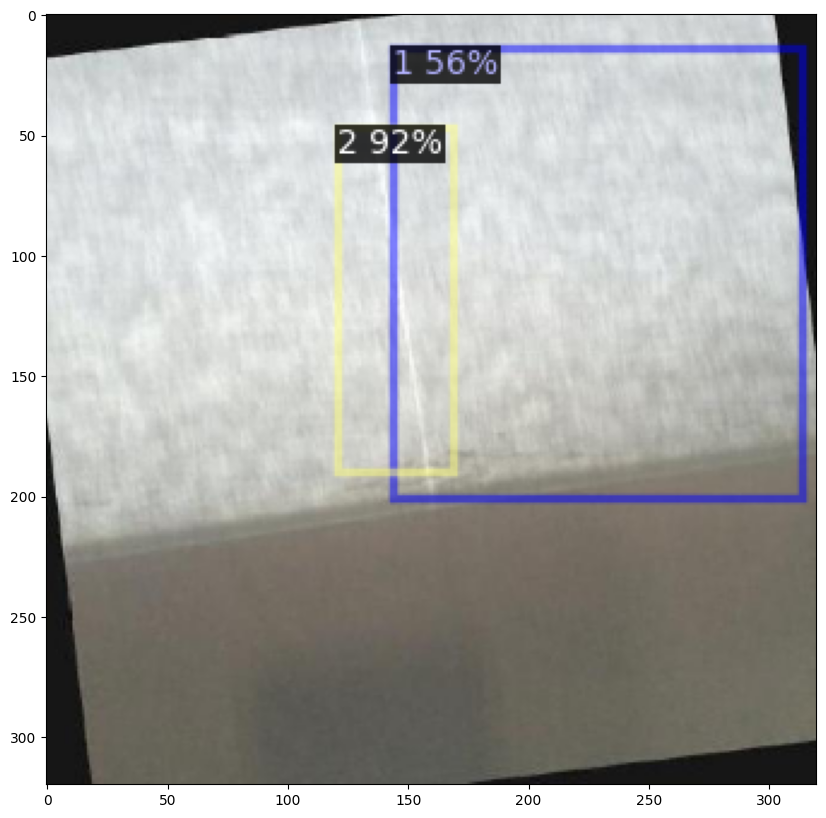

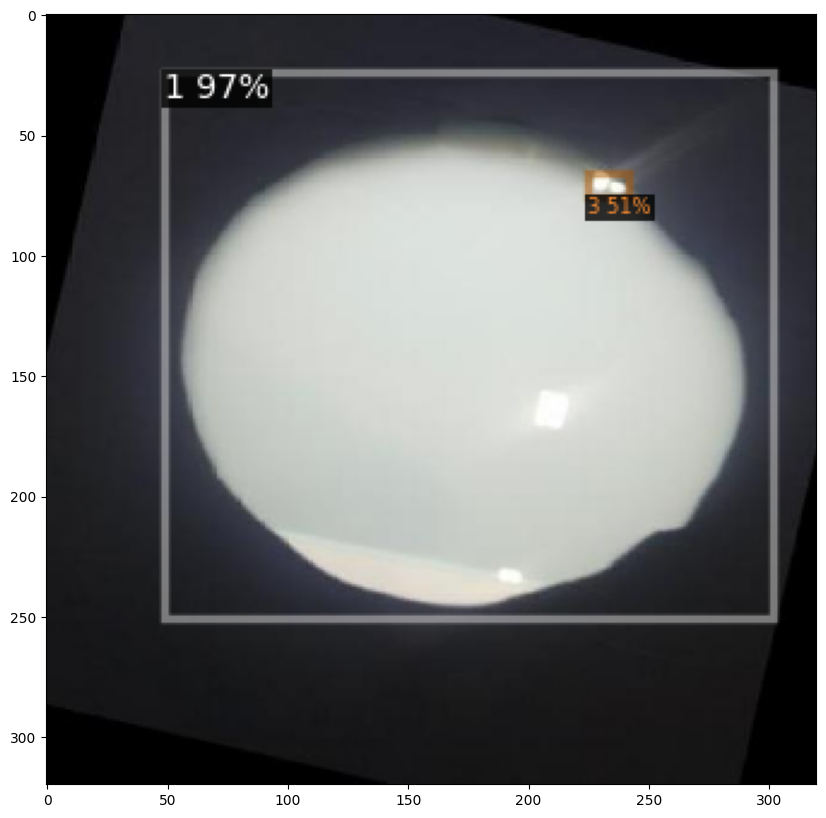

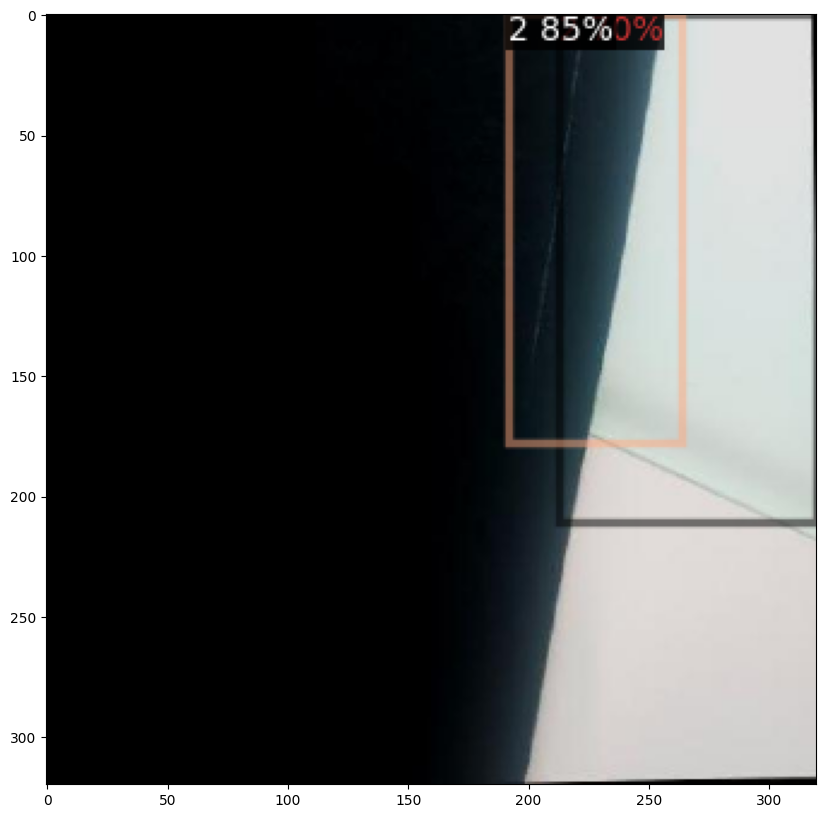

...

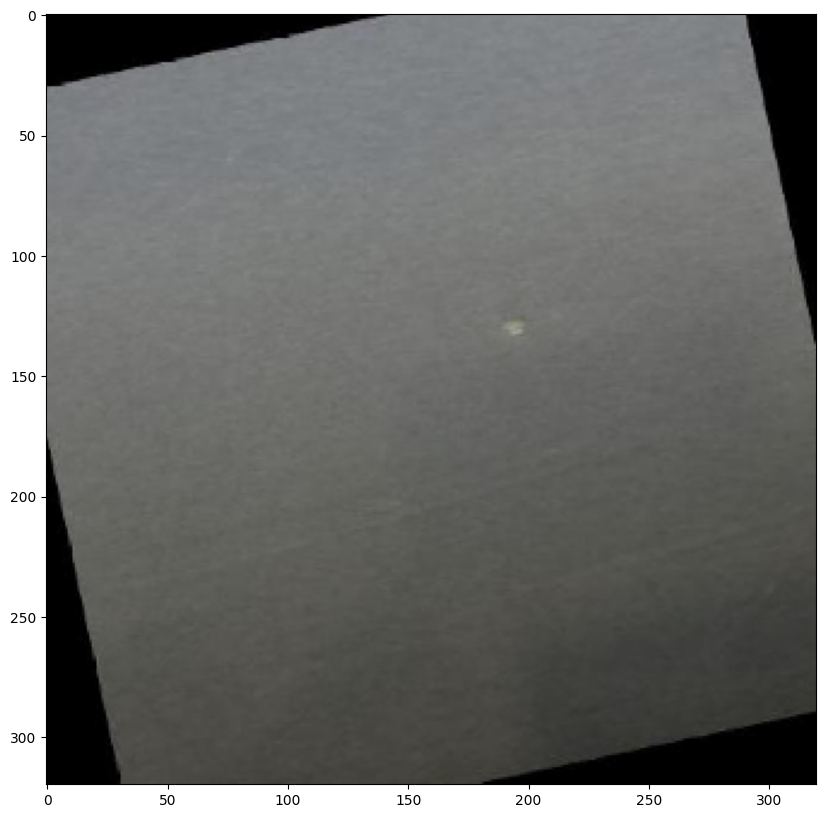

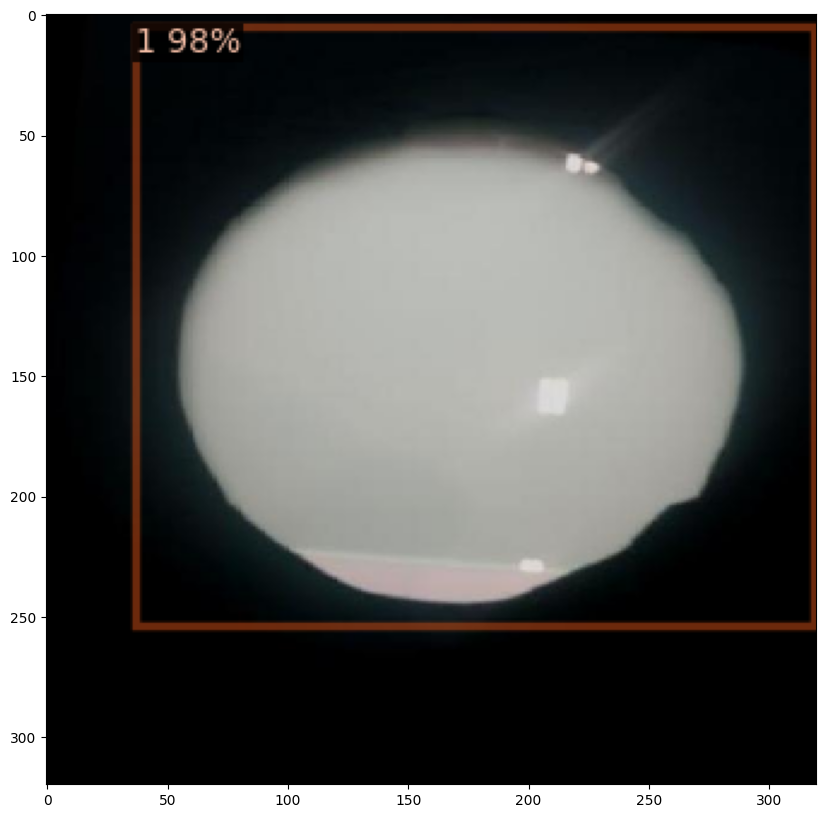

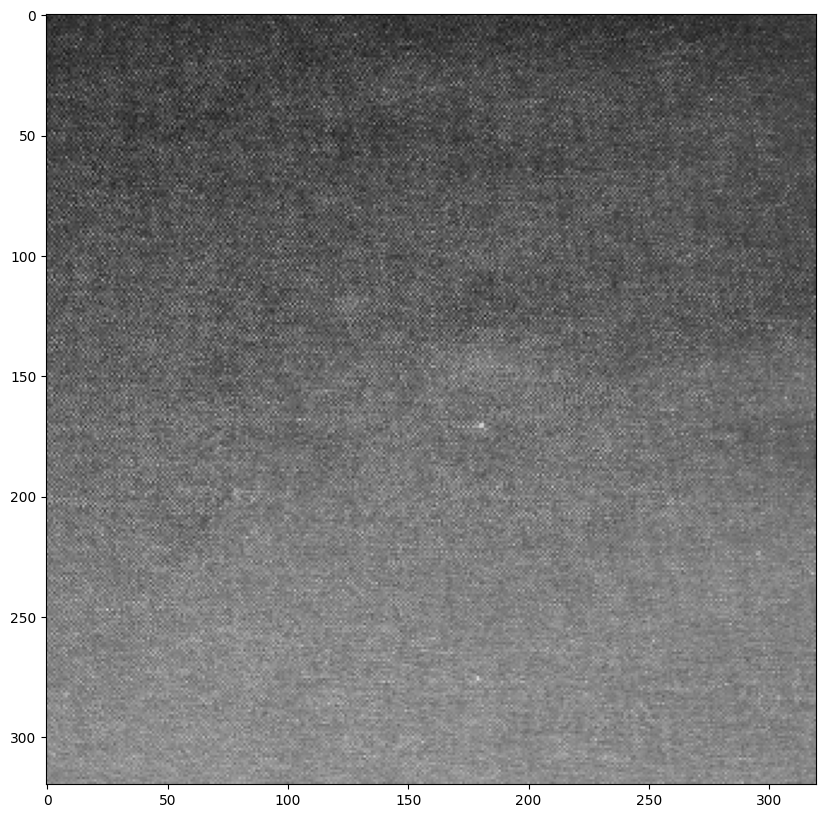

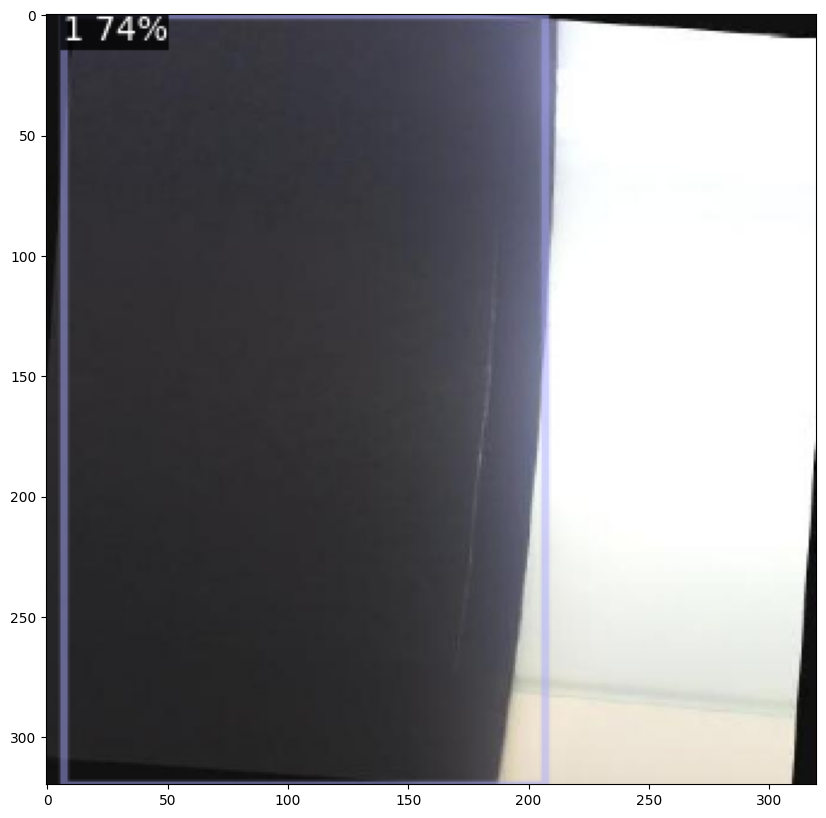

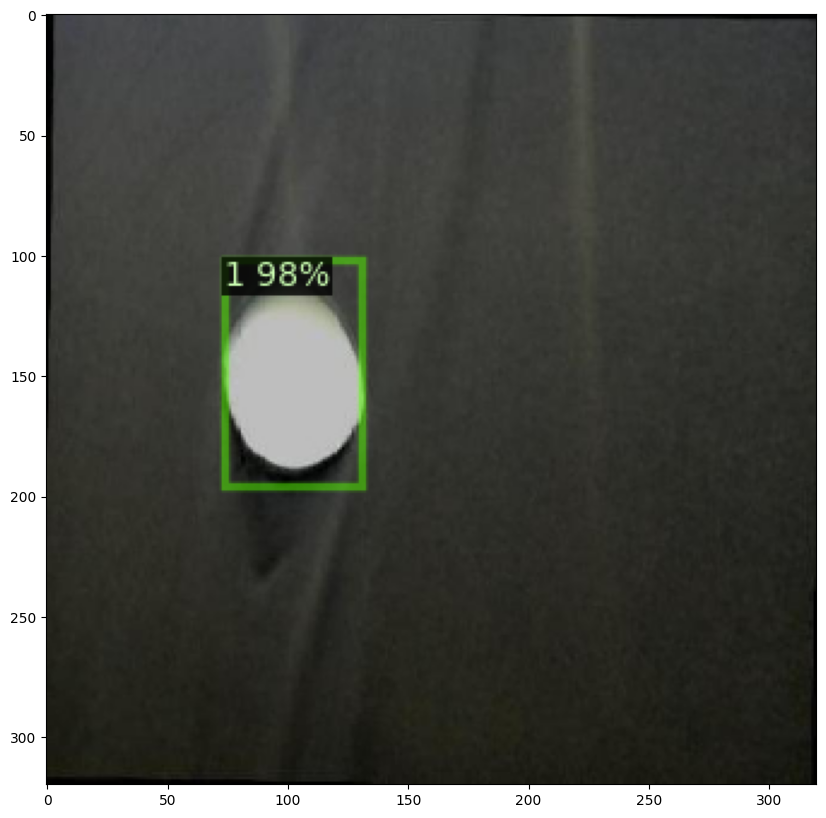

In [ ]:
import matplotlib.pyplot as plt
for d in random.sample(dataset_dict, 17):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1],

                   scale=0.5,
                   #instance_mode=ColorMode.IMAGE_BW # removes the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (10, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

In [ ]:
%cd /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT

/content/drive/.shortcut-targets-by-id/1gFoE25D0Fa7yhRPUhEyubH5zpiAT8Kzw/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT


# **R101-FPN**

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("exr",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")# initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.005
cfg.SOLVER.MAX_ITER = 400   # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  # 3 classes (Person, Helmet, Car)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/30 19:12:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f6e8b1.pkl: 243MB [00:01, 222MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/30 19:12:23 d2.engine.train_loop]: Starting training from iteration 0
[05/30 19:12:33 d2.utils.events]:  eta: 0:03:16  iter: 19  total_loss: 1.649  loss_cls: 1.068  loss_box_reg: 0.2885  loss_rpn_cls: 0.01957  loss_rpn_loc: 0.009762    time: 0.5135  last_time: 0.4817  data_time: 0.0213  last_data_time: 0.0147   lr: 0.00024226  max_mem: 3049M
[05/30 19:12:43 d2.utils.events]:  eta: 0:02:53  iter: 39  total_loss: 0.6508  loss_cls: 0.2722  loss_box_reg: 0.3017  loss_rpn_cls: 0.01401  loss_rpn_loc: 0.01244    time: 0.4957  last_time: 0.4532  data_time: 0.0098  last_data_time: 0.0065   lr: 0.00049201  max_mem: 3049M
[05/30 19:12:52 d2.utils.events]:  eta: 0:02:41  iter: 59  total_loss: 0.603  loss_cls: 0.2241  loss_box_reg: 0.3313  loss_rpn_cls: 0.006031  loss_rpn_loc: 0.006815    time: 0.4865  last_time: 0.5344  data_time: 0.0095  last_data_time: 0.0065   lr: 0.00074176  max_mem: 3049M
[05/30 19:13:02 d2.utils.events]:  eta: 0:02:32  iter: 79  total_loss: 0.5575  loss_cls: 0.1733  loss

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("exr", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "exr", mapper=None)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/30 19:16:01 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/30 19:16:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/30 19:16:01 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 19:16:01 d2.data.datasets.coco]: Loaded 336 images in COCO format from /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/train/_annotations.coco.json
[05/30 19:16:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/30 19:16:01 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/30 19:16:01 d2.data.common]: Serializing 336 elements to byte tensors and concatenating them all ...
[

OrderedDict([('bbox',
              {'AP': 42.572330365476375,
               'AP50': 69.07145550260806,
               'AP75': 44.53666832805864,
               'APs': 14.515403051287054,
               'APm': 16.19642197428698,
               'APl': 70.75511444650685,
               'AP-knot-broken-smallhole-bighole-': nan,
               'AP-big hole': 79.1021742681787,
               'AP-broken': 62.404005876771876,
               'AP-knot': 28.783141316954925,
               'AP-small hole': 0.0})])

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4   # set the testing threshold for this model
cfg.DATASETS.TEST = ("x",)
predictor = DefaultPredictor(cfg)

[05/30 19:19:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


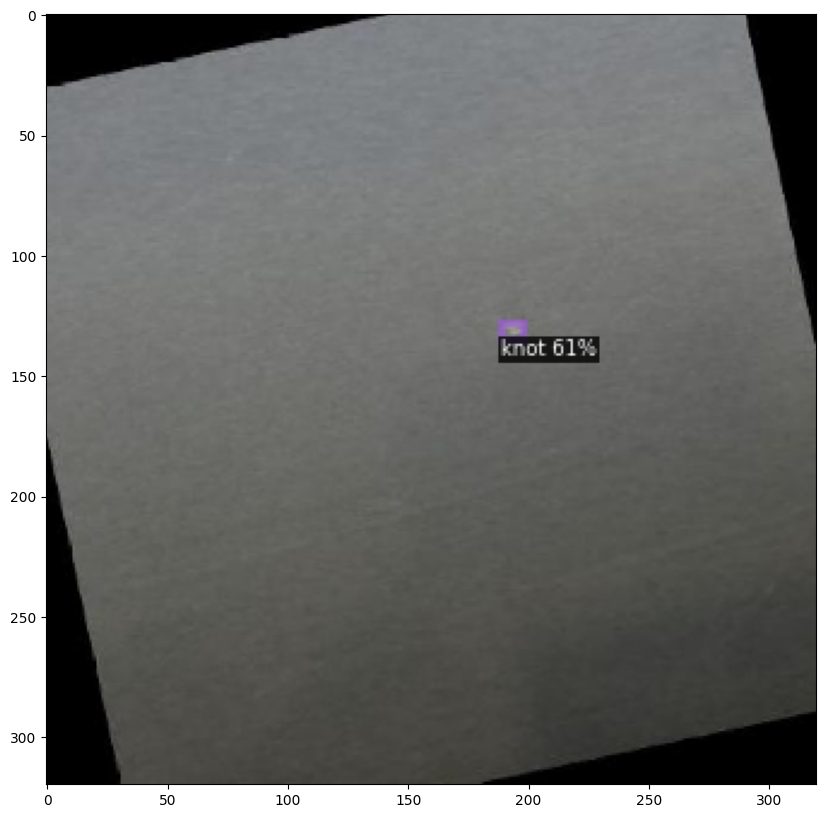

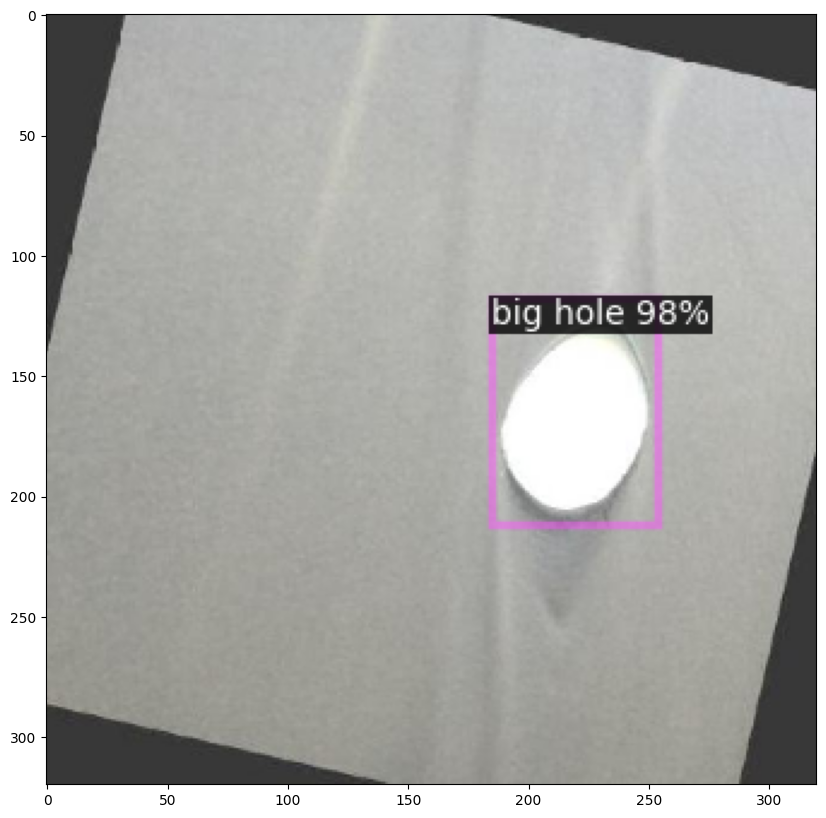

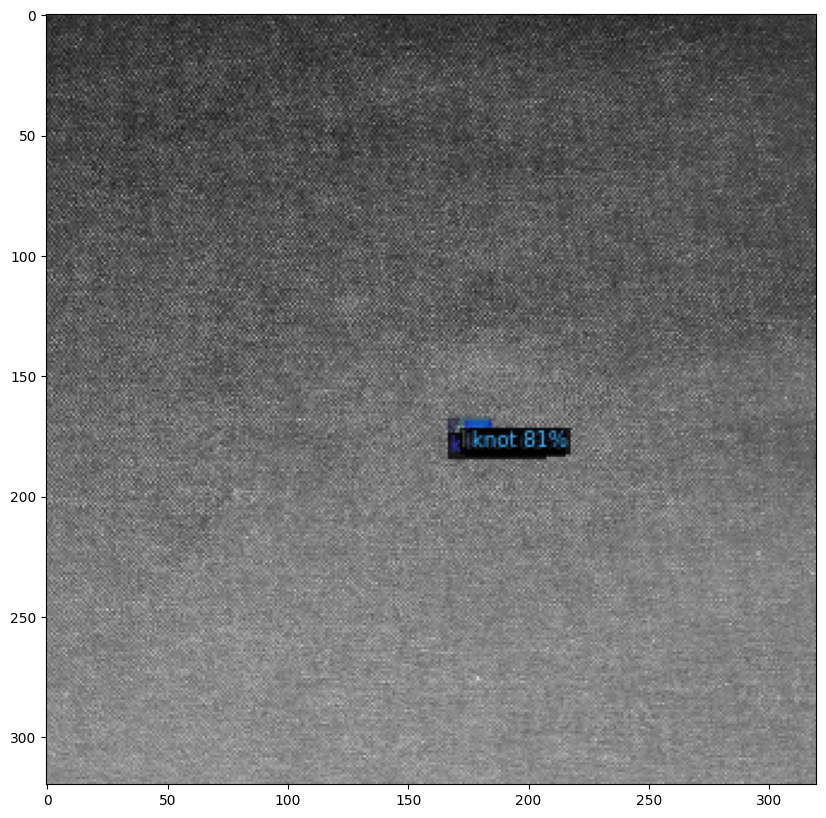

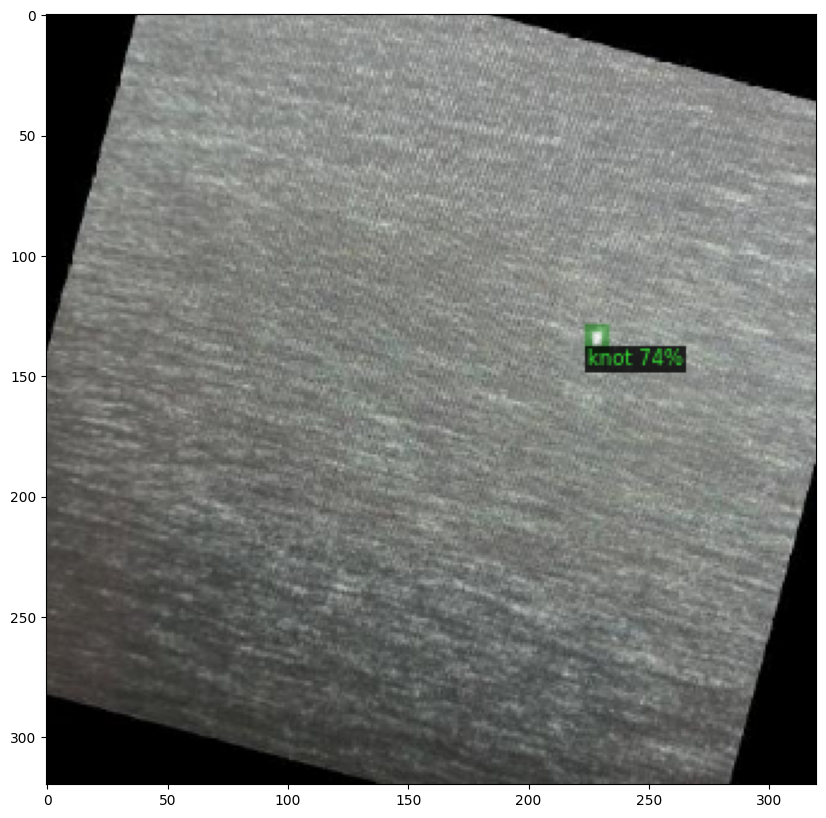

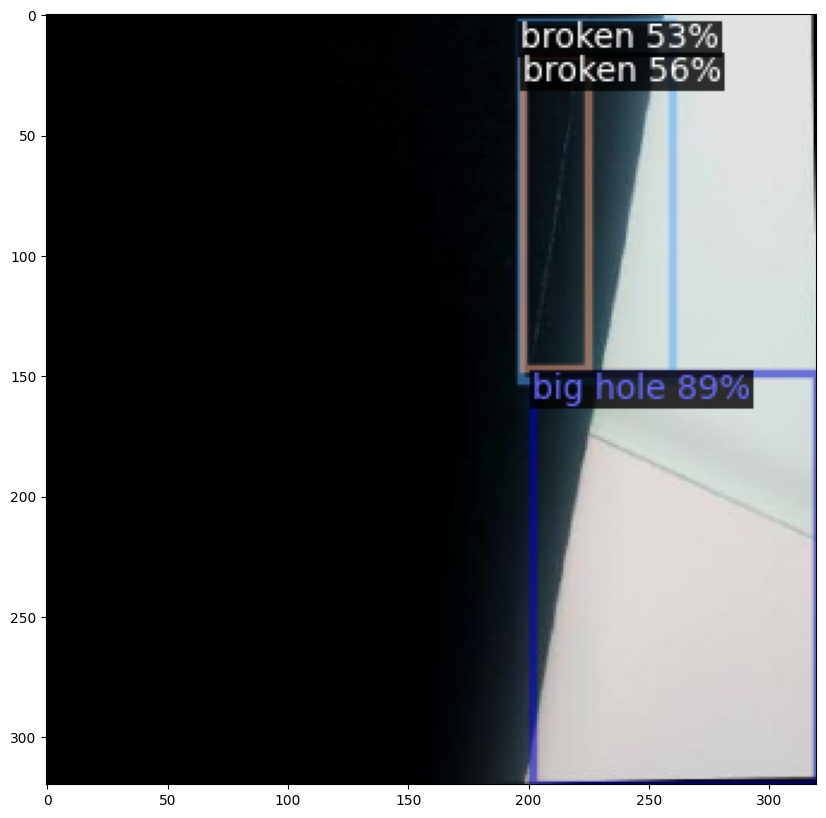

...

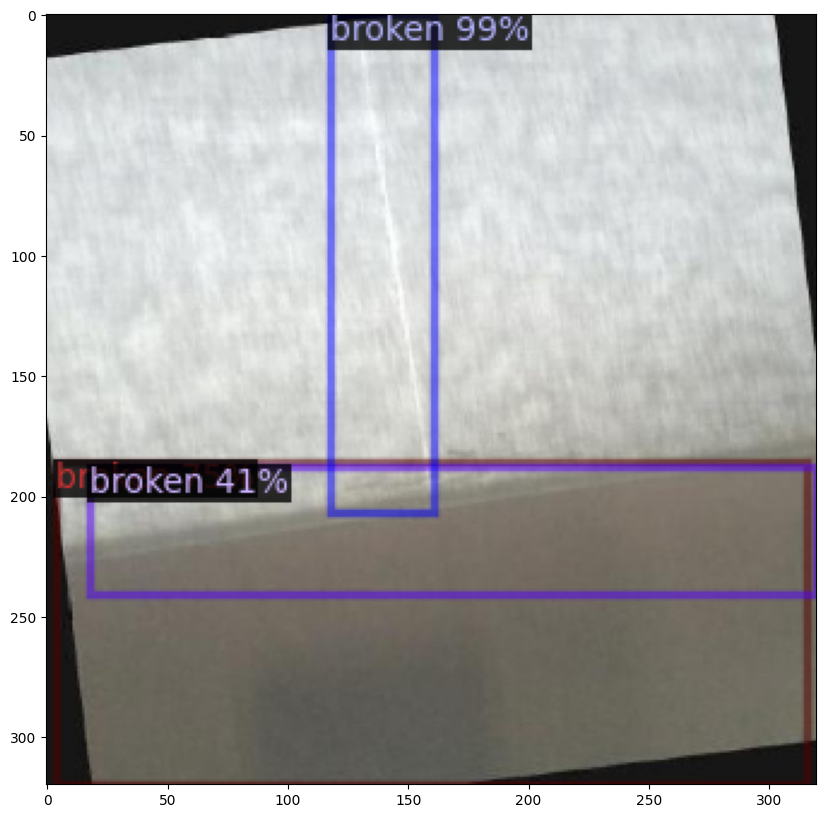

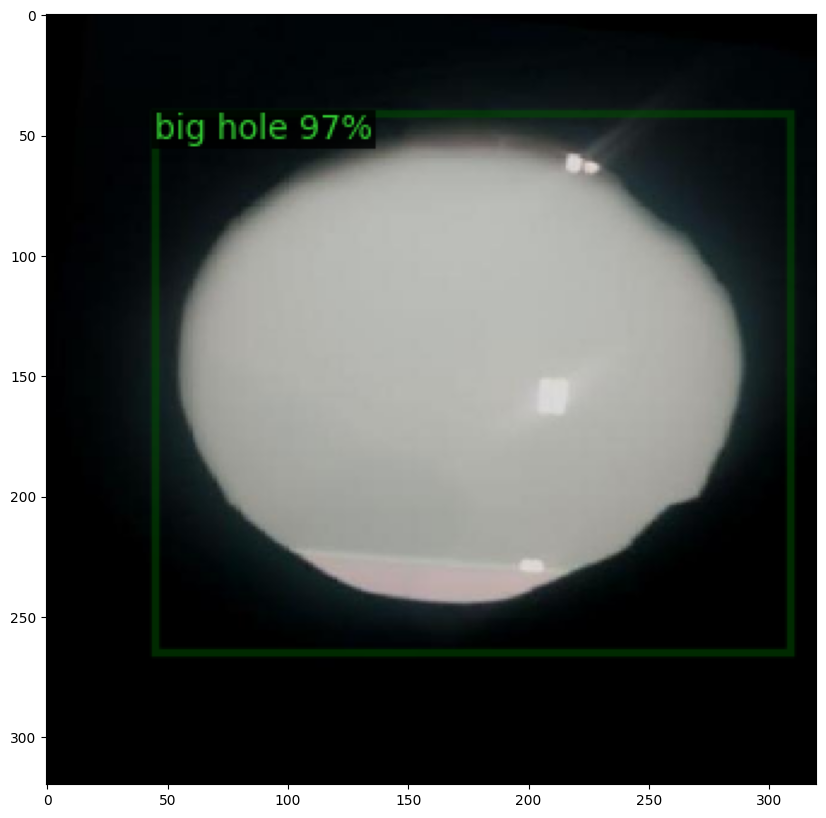

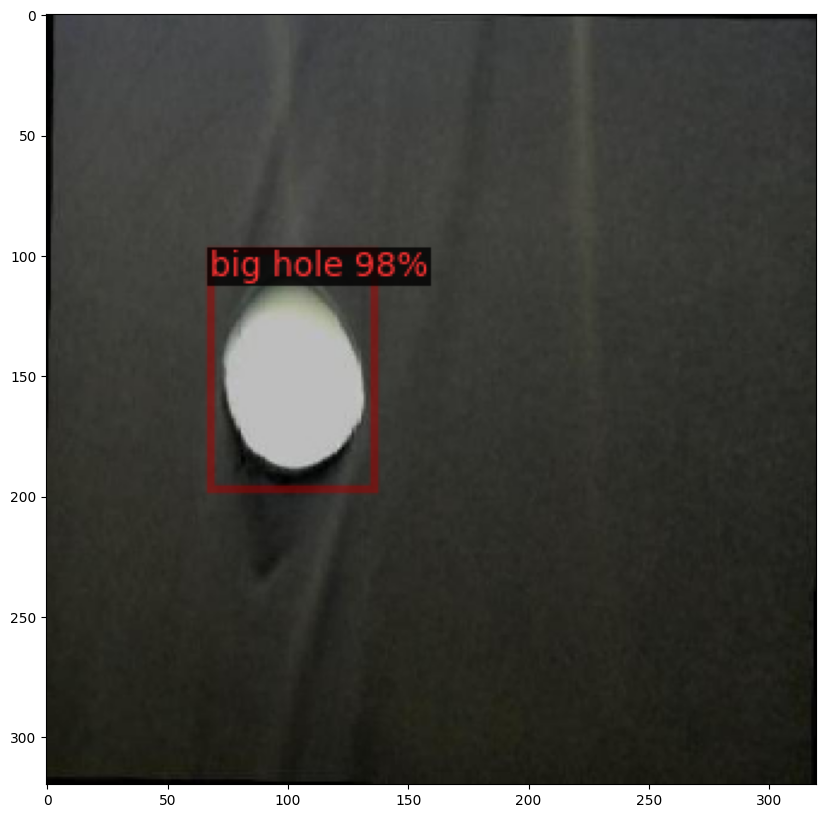

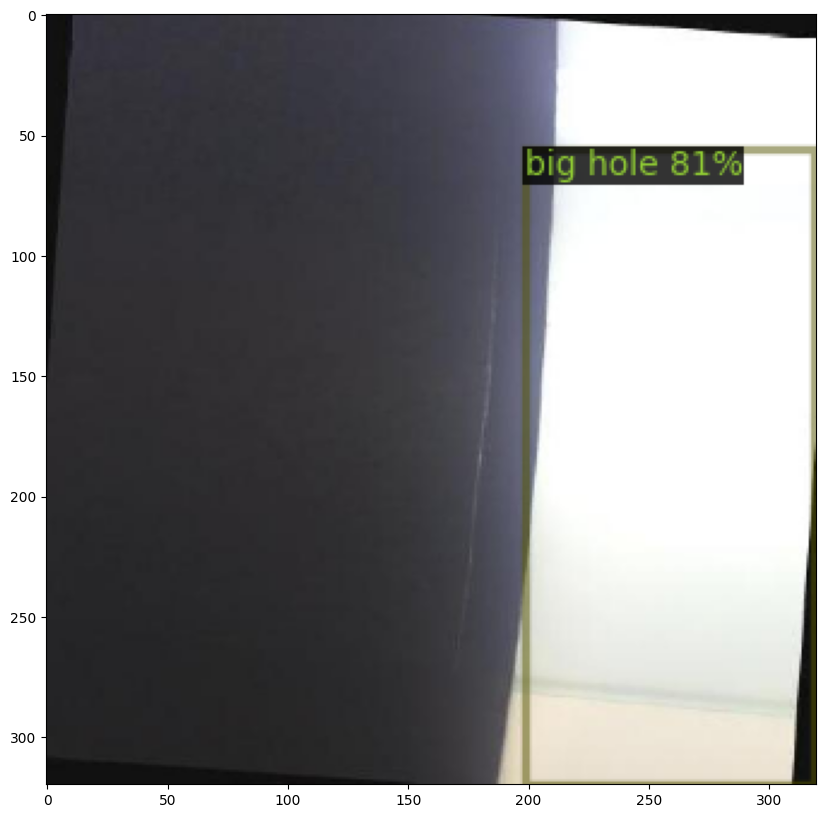

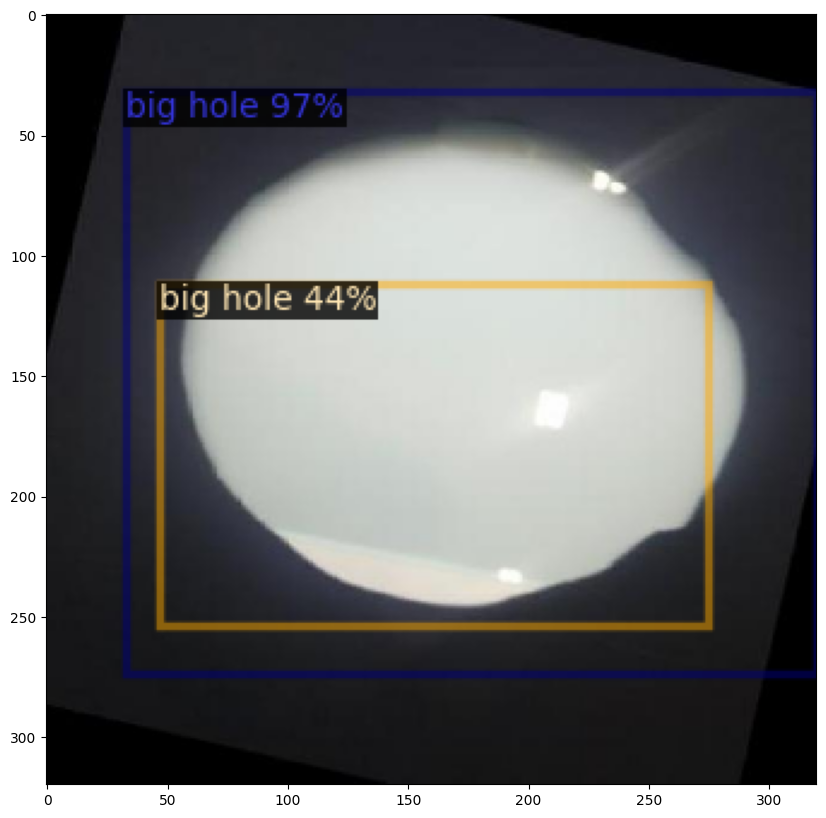

In [ ]:
import matplotlib.pyplot as plt
for d in random.sample(dataset_dict, 17):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1],
                   metadata=microcontroller_metadata,
                   scale=0.5,
                   #instance_mode=ColorMode.IMAGE_BW # removes the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (10, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

# ***R101-DC5***





In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_DC5_3x.yaml"))
cfg.DATASETS.TRAIN = ("exr",)
cfg.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_DC5_3x.yaml")# initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.005
cfg.SOLVER.MAX_ITER = 400   # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4  # 3 classes (Person, Helmet, Car)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/30 19:21:26 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

model_final_3e0943.pkl: 739MB [00:06, 119MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/30 19:21:33 d2.engine.train_loop]: Starting training from iteration 0
[05/30 19:21:47 d2.utils.events]:  eta: 0:04:16  iter: 19  total_loss: 1.653  loss_cls: 1.083  loss_box_reg: 0.2807  loss_rpn_cls: 0.07303  loss_rpn_loc: 0.008111    time: 0.6982  last_time: 0.6794  data_time: 0.0227  last_data_time: 0.0057   lr: 0.00024226  max_mem: 4246M
[05/30 19:22:01 d2.utils.events]:  eta: 0:04:06  iter: 39  total_loss: 0.896  loss_cls: 0.3366  loss_box_reg: 0.4047  loss_rpn_cls: 0.04838  loss_rpn_loc: 0.02151    time: 0.7031  last_time: 0.7971  data_time: 0.0100  last_data_time: 0.0053   lr: 0.00049201  max_mem: 4246M
[05/30 19:22:15 d2.utils.events]:  eta: 0:03:52  iter: 59  total_loss: 0.8461  loss_cls: 0.2513  loss_box_reg: 0.4959  loss_rpn_cls: 0.02304  loss_rpn_loc: 0.01238    time: 0.7020  last_time: 0.7729  data_time: 0.0079  last_data_time: 0.0061   lr: 0.00074176  max_mem: 4246M
[05/30 19:22:28 d2.utils.events]:  eta: 0:03:34  iter: 79  total_loss: 0.603  loss_cls: 0.1706  loss_bo

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("exr", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "exr", mapper=None)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/30 19:26:27 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [05/30 19:26:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/30 19:26:27 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/30 19:26:27 d2.data.datasets.coco]: Loaded 336 images in COCO format from /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/train/_annotations.coco.json
[05/30 19:26:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[05/30 19:26:27 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[05/30 19:26:27 d2.data.common]: Serializing 336 elements to byte tensors and concatenating them all ...
[

OrderedDict([('bbox',
              {'AP': 34.62657251837249,
               'AP50': 57.19626106169061,
               'AP75': 38.69942381374016,
               'APs': 5.82507514157971,
               'APm': 8.415841584158416,
               'APl': 63.20041269825257,
               'AP-knot-broken-smallhole-bighole-': nan,
               'AP-big hole': 75.87340194392974,
               'AP-broken': 50.509080352084034,
               'AP-knot': 12.1238077774762,
               'AP-small hole': 0.0})])

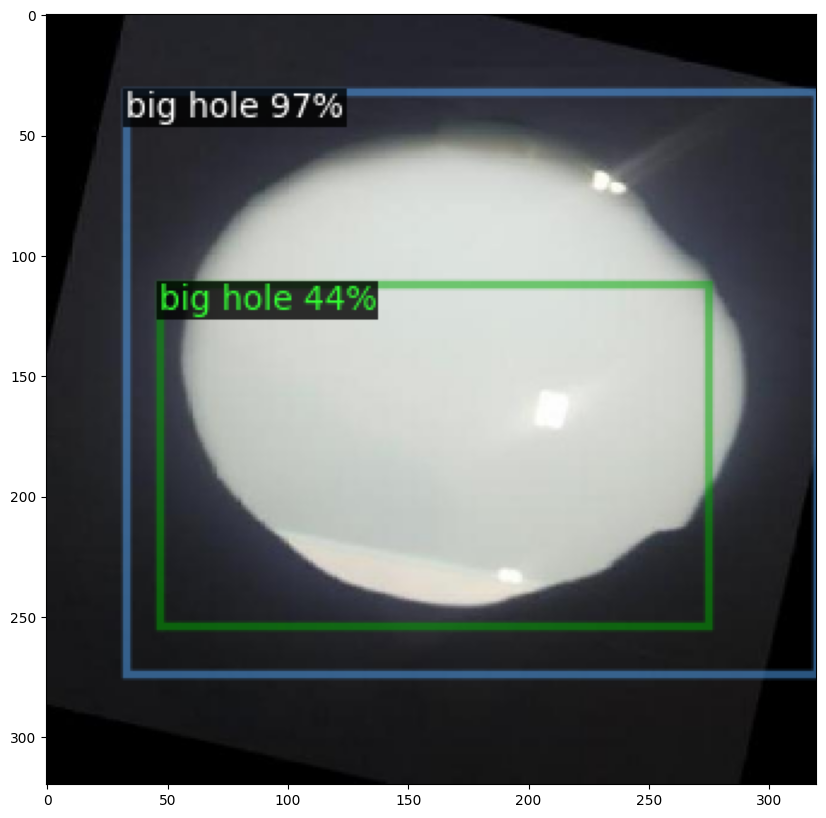

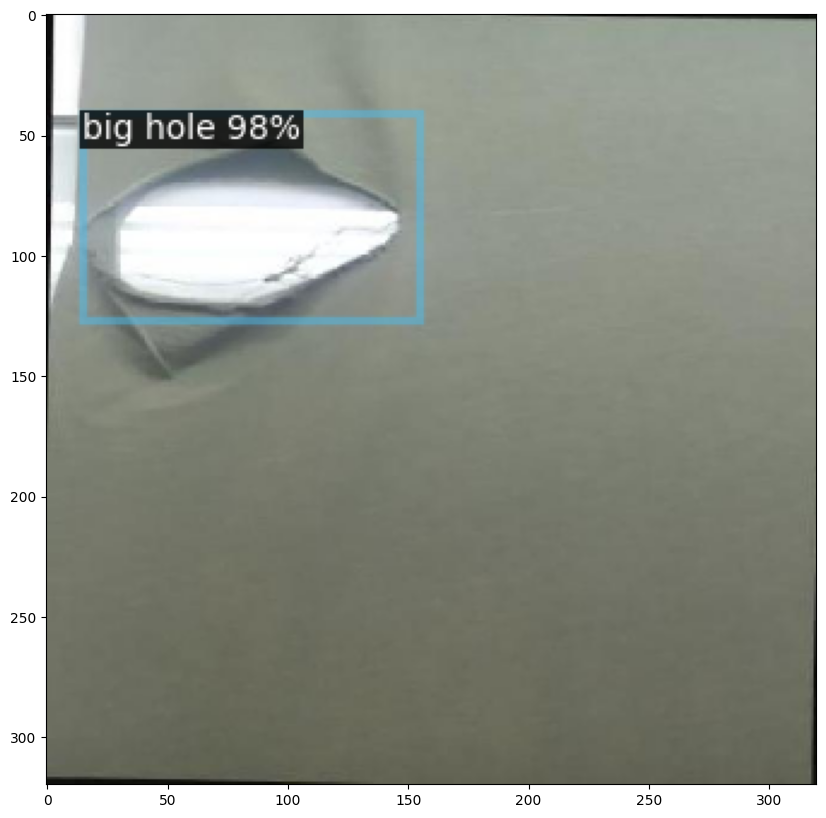

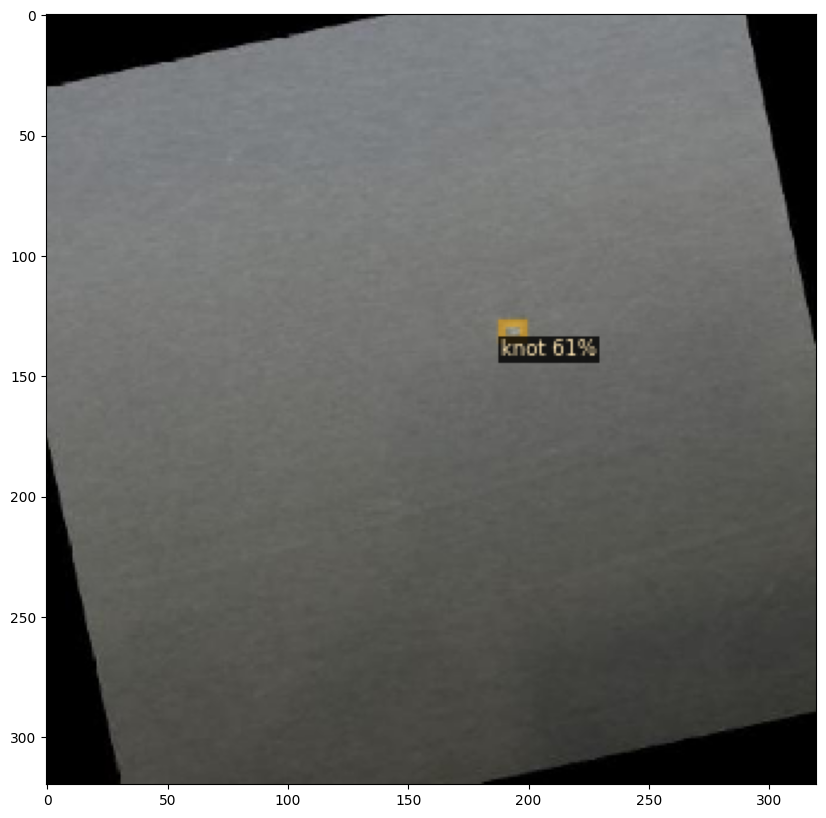

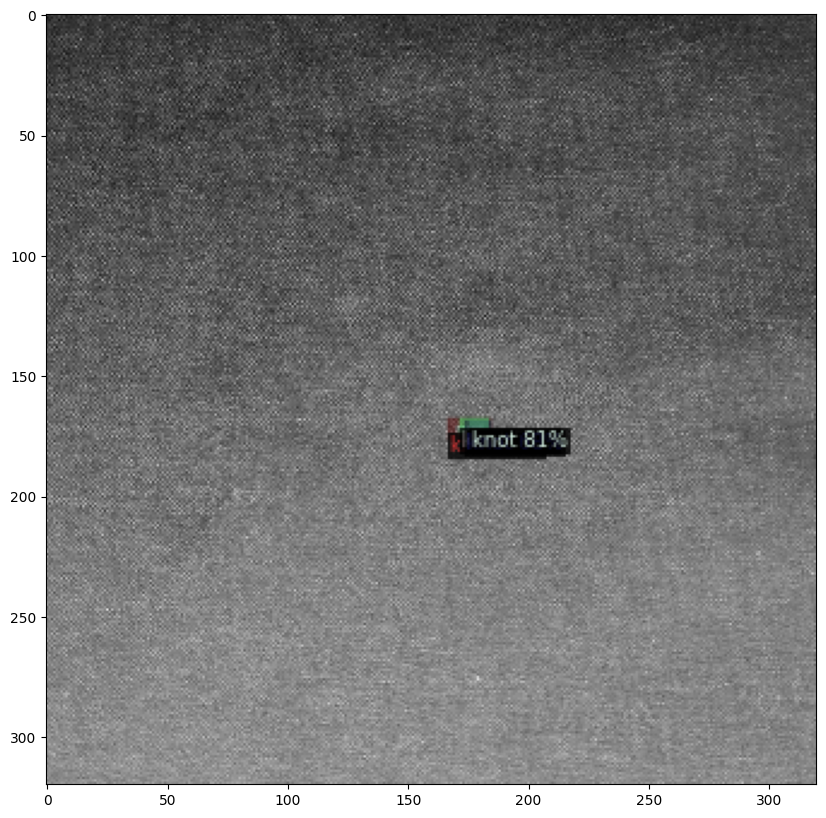

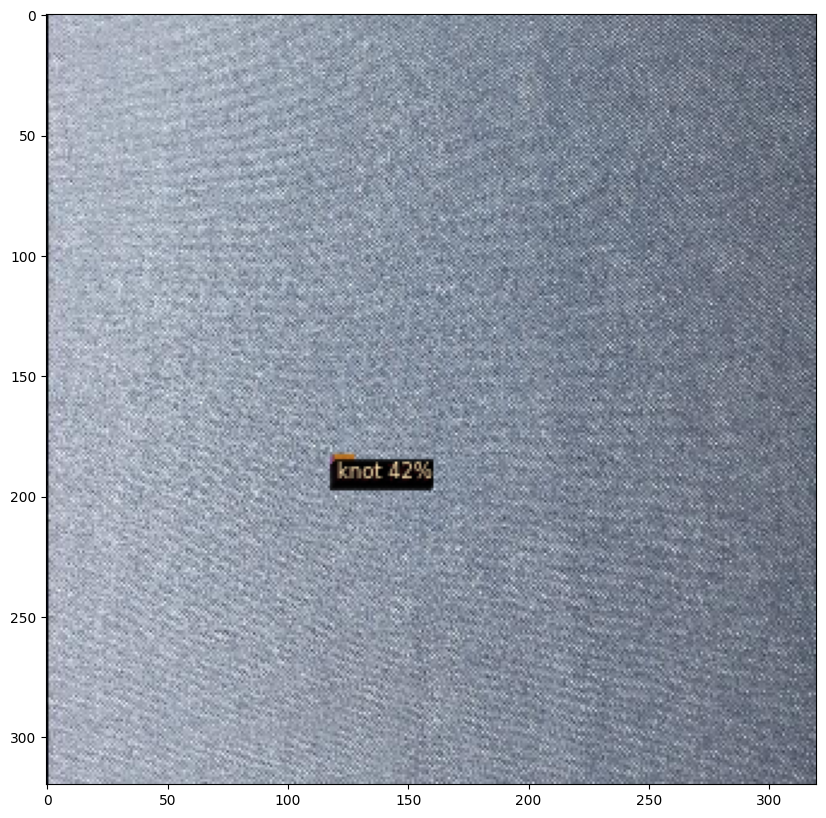

...

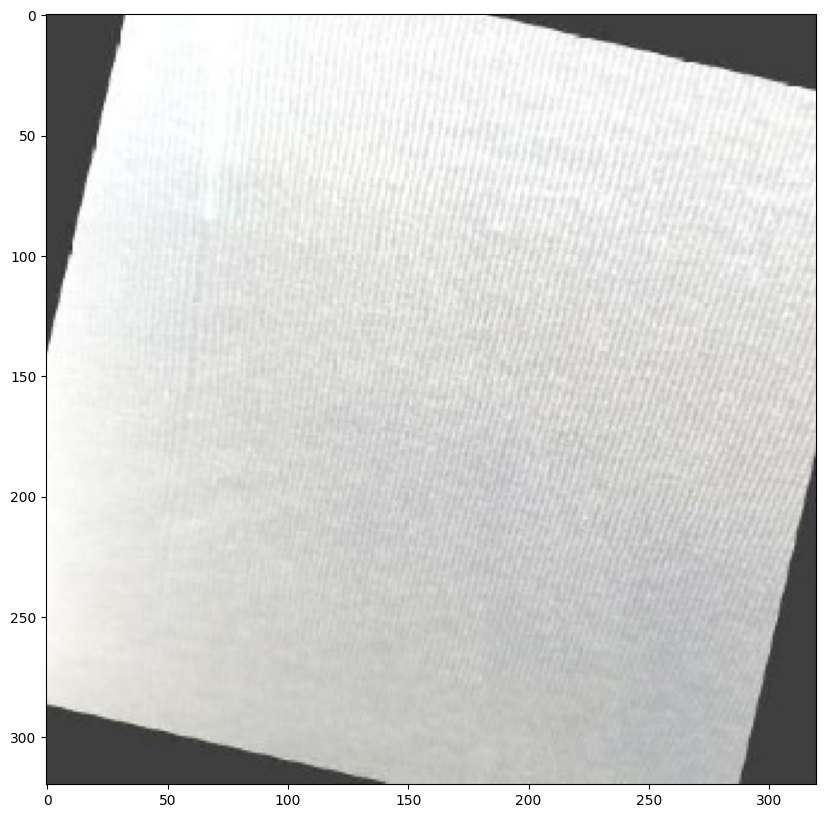

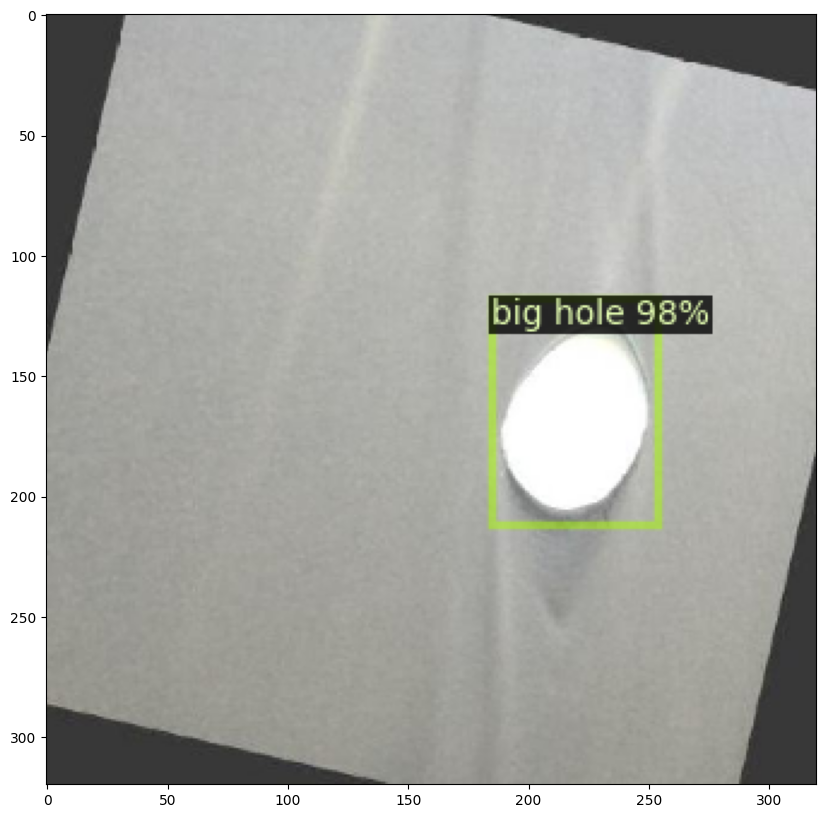

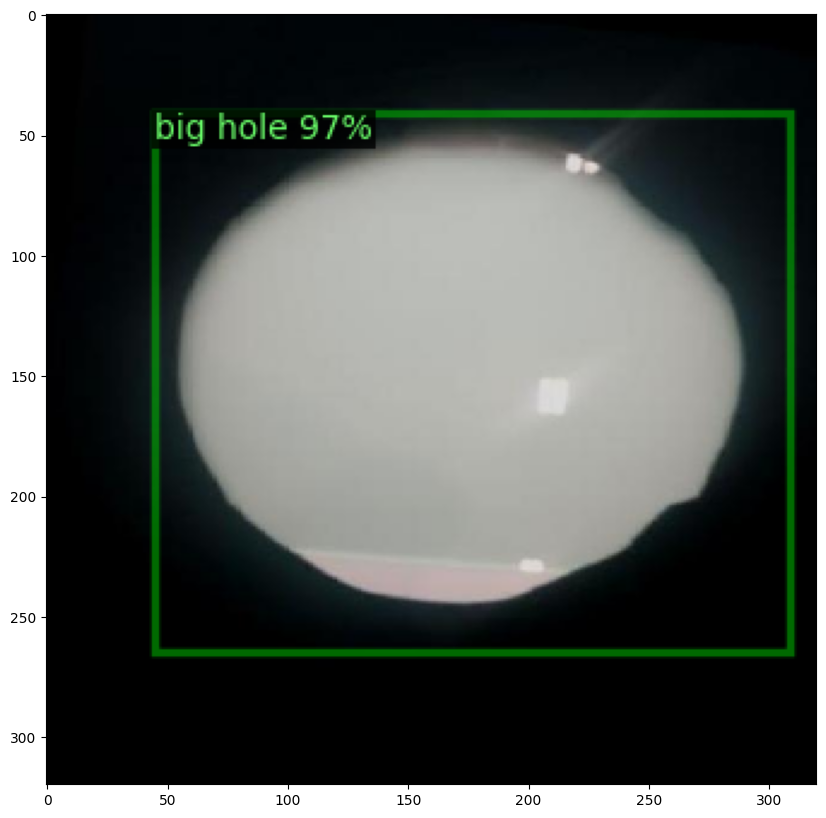

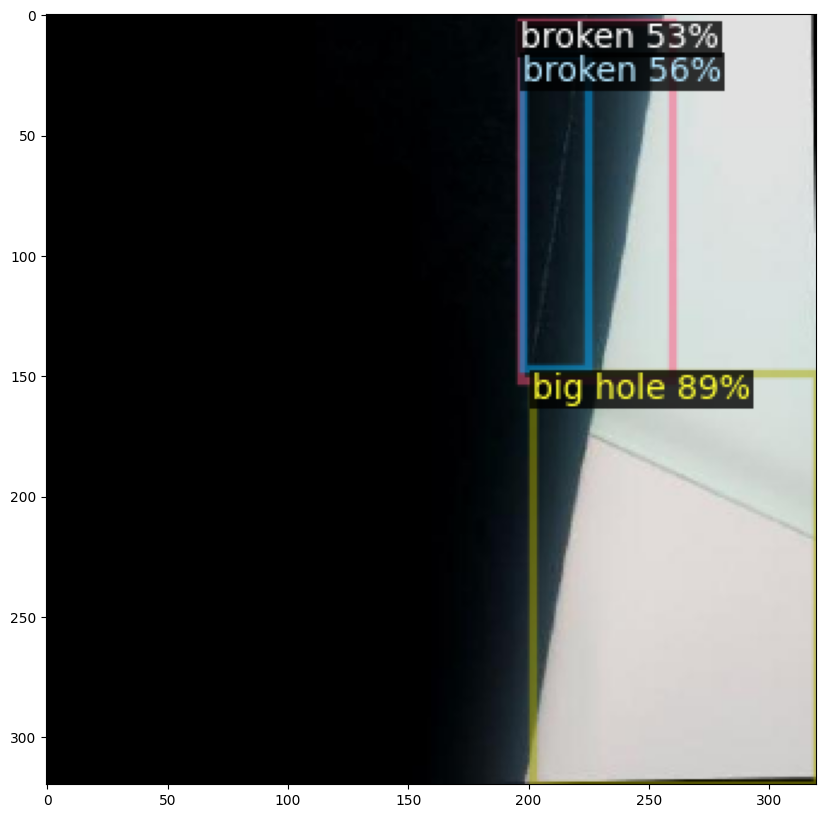

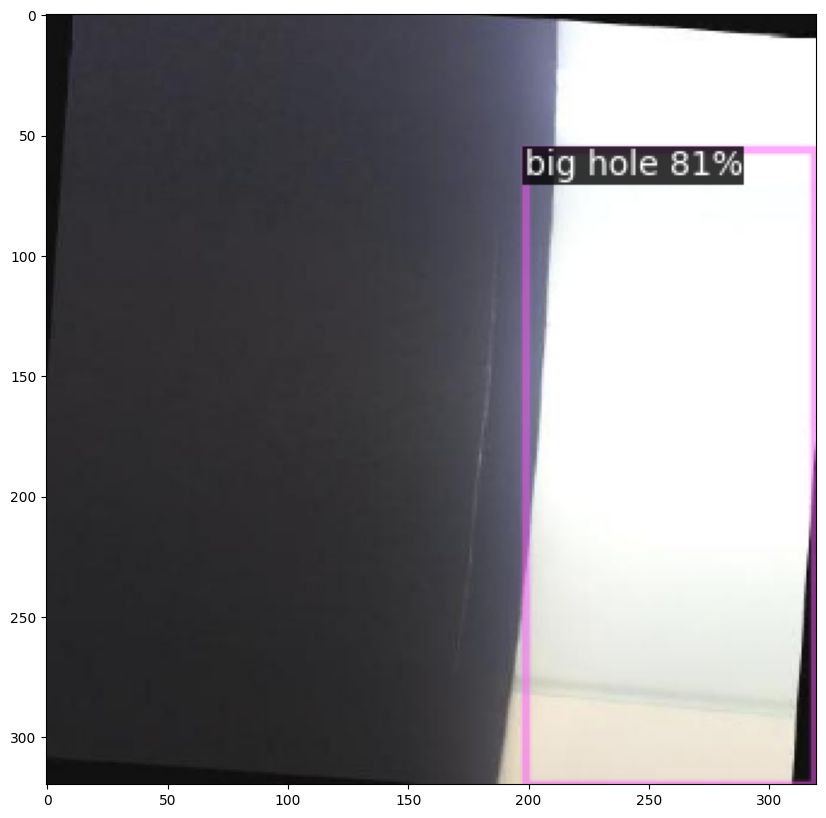

In [ ]:
import matplotlib.pyplot as plt
for d in random.sample(dataset_dict, 17):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1],
                   metadata=microcontroller_metadata,
                   scale=0.5,
                   #instance_mode=ColorMode.IMAGE_BW # removes the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (10, 10))
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

# **Test on Videos**

In [ ]:
from detectron2.config import get_cfg
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_DC5_3x.yaml")) #Yapılandırma Dosyası
cfg.DATASETS.TRAIN = ("exr",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.GAMMA = 0.005
cfg.SOLVER.STEPS = [500]
cfg.TEST.EVAL_PERIOD = 200
cfg.SOLVER.MAX_ITER = 2000
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 4
cfg.MODEL.WEIGHTS = "/content/output/model_final.pth"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.58


cfg.merge_from_list(["MODEL.WEIGHTS", "weights.pth"])   # can also load values from a list of str
print(cfg.dump())  # print formatted configs
with open("output.yaml", "w") as f:
  f.write(cfg.dump())   # save config to file

CUDNN_BENCHMARK: false
DATALOADER:
  ASPECT_RATIO_GROUPING: true
  FILTER_EMPTY_ANNOTATIONS: true
  NUM_WORKERS: 2
  REPEAT_THRESHOLD: 0.0
  SAMPLER_TRAIN: TrainingSampler
DATASETS:
  PRECOMPUTED_PROPOSAL_TOPK_TEST: 1000
  PRECOMPUTED_PROPOSAL_TOPK_TRAIN: 2000
  PROPOSAL_FILES_TEST: []
  PROPOSAL_FILES_TRAIN: []
  TEST: []
  TRAIN:
  - exr
GLOBAL:
  HACK: 1.0
INPUT:
  CROP:
    ENABLED: false
    SIZE:
    - 0.9
    - 0.9
    TYPE: relative_range
  FORMAT: BGR
  MASK_FORMAT: polygon
  MAX_SIZE_TEST: 1333
  MAX_SIZE_TRAIN: 1333
  MIN_SIZE_TEST: 800
  MIN_SIZE_TRAIN:
  - 640
  - 672
  - 704
  - 736
  - 768
  - 800
  MIN_SIZE_TRAIN_SAMPLING: choice
  RANDOM_FLIP: horizontal
MODEL:
  ANCHOR_GENERATOR:
    ANGLES:
    - - -90
      - 0
      - 90
    ASPECT_RATIOS:
    - - 0.5
      - 1.0
      - 2.0
    NAME: DefaultAnchorGenerator
    OFFSET: 0.0
    SIZES:
    - - 32
      - 64
      - 128
      - 256
      - 512
  BACKBONE:
    FREEZE_AT: 2
    NAME: build_resnet_backbone
  DEVICE: cuda

In [ ]:
%run detectron2/demo/demo.py --config-file /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT/output.yaml --video-input /content/drive/MyDrive/data_pfe/videos-pfe/big-broken.mp4 --confidence-threshold 0.58 --output video-output.mp4 \
  --opts MODEL.WEIGHTS /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT/output/model_final.pth

[05/30 19:39:15 detectron2]: Arguments: Namespace(config_file='/content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT/output.yaml', webcam=False, video_input='/content/drive/MyDrive/data_pfe/videos-pfe/big-broken.mp4', input=None, output='video-output.mp4', confidence_threshold=0.58, opts=['MODEL.WEIGHTS', '/content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT/output/model_final.pth'])
[05/30 19:39:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT/output/model_final.pth ...
[05/30 19:39:18 fvcore.common.checkpoint]: [Checkpointer] Loading from /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT/output/model_final.pth ...


100%|██████████| 2607/2607 [23:53<00:00,  1.82it/s]


In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!git clone https://github.com/facebookresearch/detectron2

Cloning into 'detectron2'...
remote: Enumerating objects: 15057, done.
remote: Counting objects: 100% (82/82), done.
remote: Compressing objects: 100% (45/45), done.
remote: Total 15057 (delta 38), reused 69 (delta 37), pack-reused 14975
Receiving objects: 100% (15057/15057), 6.12 MiB | 6.16 MiB/s, done.
Resolving deltas: 100% (10903/10903), done.
Updating files: 100% (820/820), done.


In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/data_pfe/data_collected/four_defects.v1i.coco/OUTPUT/C4